# Background removal with Azure Computer Vision 4

**The Image Analysis** service can divide images into multiple segments or regions to help the user identify different objects or parts of the image. **Background removal** creates an alpha matte that separates the foreground object from the background in an image.


This feature provides two possible outputs based on the customer's needs:

- The **foreground object** of the image without the background. This edited image shows the foreground object and makes the background transparent, allowing the foreground to be placed on a new background.
- An **alpha matte** that shows the opacity of the detected foreground object. This matte can be used to separate the foreground object from the background for further processing.

This service is currently in preview, and the API may change in the future.

https://learn.microsoft.com/en-us/azure/cognitive-services/computer-vision/concept-background-removal

In [1]:
import json
import requests
import sys

from io import BytesIO
from PIL import Image
from urllib.parse import urlparse

In [2]:
sys.version

'3.8.5 (default, Sep  4 2020, 07:30:14) \n[GCC 7.3.0]'

In [3]:
import datetime

print("Today is", datetime.datetime.today())

Today is 2023-03-13 12:43:33.565179


In [4]:
import psutil  

disk = psutil.disk_usage('/')
memory = psutil.virtual_memory()

print("Available disk space:", round(disk.free / (1024 * 1024 * 1024), 2), "GB")
print("Available memory:", round(memory.available / (1024 * 1024 * 1024), 2), "GB")

Available disk space: 47.13 GB
Available memory: 52.53 GB


## Azure Computer Vision 4.0

In [5]:
endpoint = "https://yourendpoint/imageanalysis:segment?api-version=2023-02-01-preview"
background_removal = "&mode=backgroundRemoval"
foreground_matting = "&mode=foregroundMatting"

remove_background_url = endpoint + background_removal  # For removing the background
get_mask_object_url = endpoint + foreground_matting  # Mask of the object

headers = {
    'Content-type': 'application/json',
    'Ocp-Apim-Subscription-Key': 'yourkey'
}

## Functions

In [6]:
def remove_background(image_url):
    """
    Removing background
    """
    image = {'url': image_url}
    r = requests.post(remove_background_url,
                      data=json.dumps(image),
                      headers=headers)

    object_image = "object_" + os.path.basename(urlparse(image_url).path)

    with open(object_image, 'wb') as f:
        f.write(r.content)

    return Image.open(object_image)

In [7]:
def get_mask(image_url):
    """
    Get Mask
    """
    image = {'url': image_url}
    r = requests.post(get_mask_object_url,
                      data=json.dumps(image),
                      headers=headers)

    mask_image = "mask_" + os.path.basename(urlparse(image_url).path)

    with open(mask_image, 'wb') as f:
        f.write(r.content)

    return Image.open(mask_image)

In [8]:
def get_stats(image):
    """
    Pixel stats on mask image
    """
    image = image.convert('L')
    width, height = image.size
    total_pixels = width * height
    black_pixels = 0

    for x in range(width):
        for y in range(height):
            if image.getpixel((x,y)) == 0:
                black_pixels += 1

    white_pixels = total_pixels - black_pixels
    pct_whitepixels = white_pixels / total_pixels
    pct_blackpixels = black_pixels / total_pixels

    print("Number of pixels:", "{:,}".format(total_pixels))
    print("\nNumber of black pixels:", "{:,}".format(black_pixels), f"{pct_blackpixels:.2%}")
    print("Number of white pixels:", "{:,}".format(white_pixels), f"{pct_whitepixels:.2%}")

## Test 1

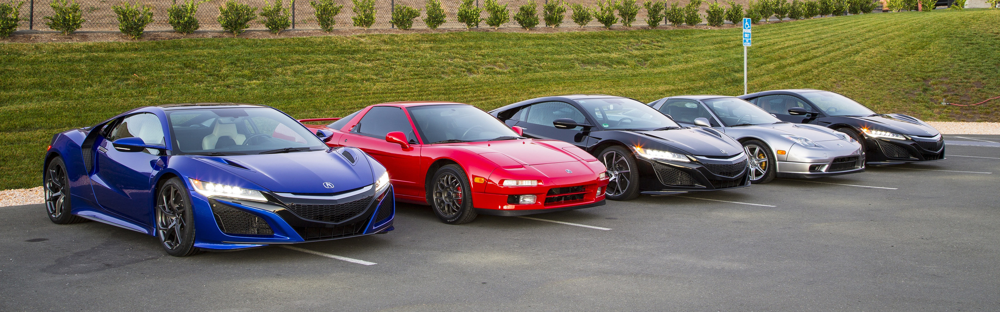

In [9]:
image_url = "https://github.com/retkowsky/removing_background_azure_computer_vision_4/blob/main/cars.jpg?raw=true"

r = requests.get(image_url)
img = Image.open(BytesIO(r.content))
img

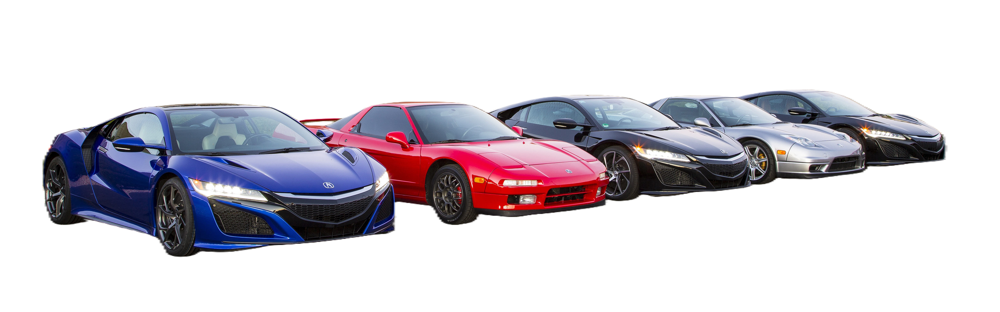

In [10]:
remove_background_img = remove_background(image_url)
remove_background_img

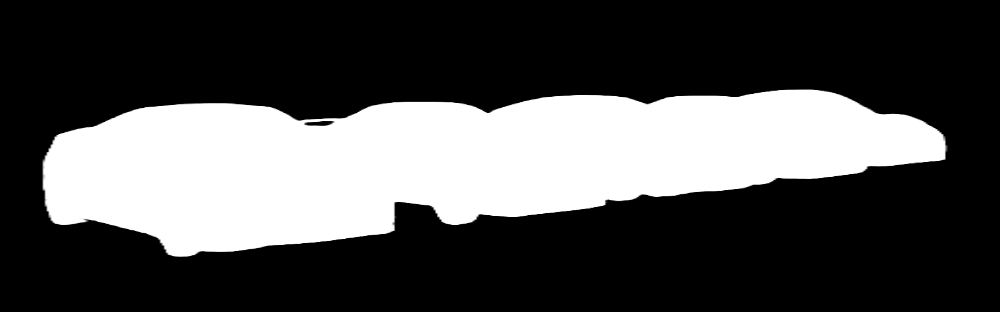

In [11]:
get_mask_img = get_mask(image_url)
get_mask_img

In [12]:
get_stats(get_mask_img)

Number of pixels: 4,608,000

Number of black pixels: 3,186,357 69.15%
Number of white pixels: 1,421,643 30.85%


## Test 2

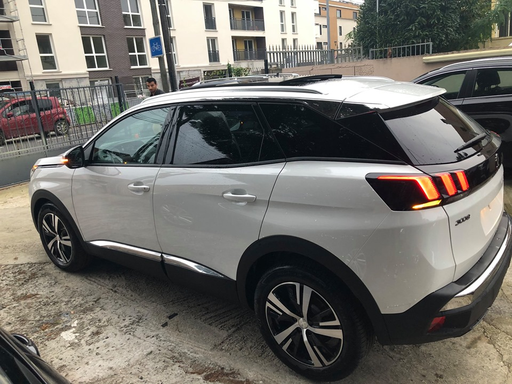

In [13]:
image_url = "https://github.com/retkowsky/removing_background_azure_computer_vision_4/blob/main/whitecar.jpg?raw=true"

r = requests.get(image_url)
img = Image.open(BytesIO(r.content))
img.thumbnail((512, 512), Image.Resampling.LANCZOS)
img

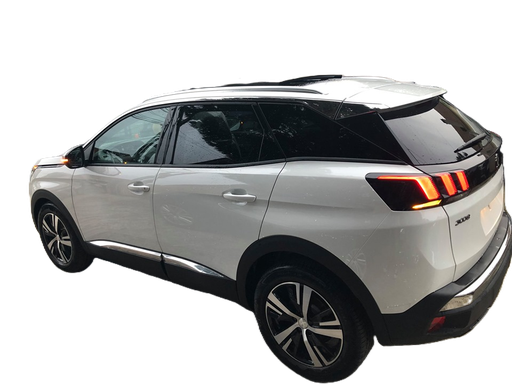

In [14]:
remove_background_img = remove_background(image_url)

remove_background_img.thumbnail((512, 512), Image.Resampling.LANCZOS)
remove_background_img

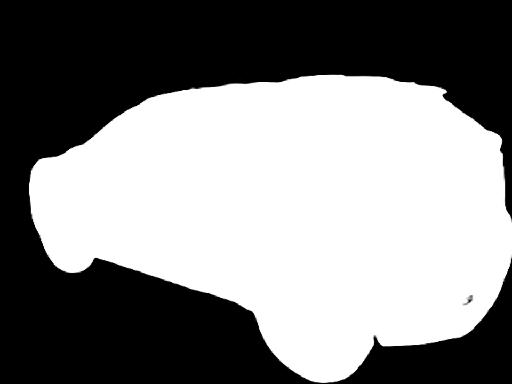

In [15]:
get_mask_img = get_mask(image_url)

get_mask_img.thumbnail((512, 512), Image.Resampling.LANCZOS)
get_mask_img

In [16]:
get_stats(get_mask_img)

Number of pixels: 196,608

Number of black pixels: 93,521 47.57%
Number of white pixels: 103,087 52.43%


## Test 3

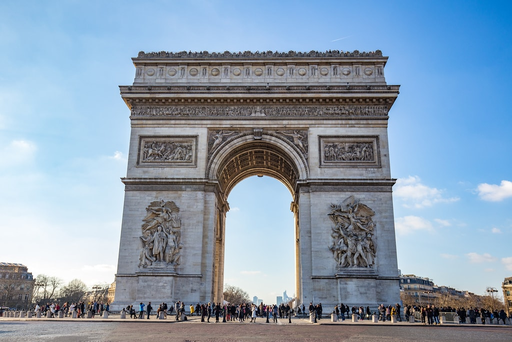

In [17]:
image_url = "https://github.com/retkowsky/removing_background_azure_computer_vision_4/blob/main/arc_triomphe.jpg?raw=true"

r = requests.get(image_url)
img = Image.open(BytesIO(r.content))
img.thumbnail((512, 512), Image.Resampling.LANCZOS)
img

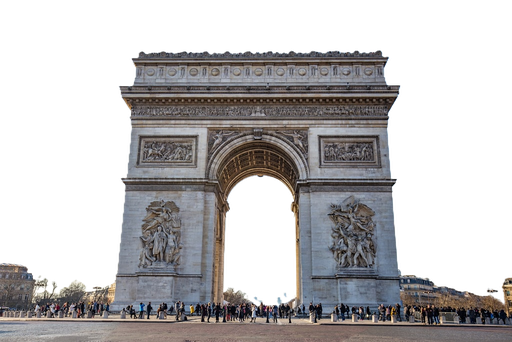

In [18]:
remove_background_img = remove_background(image_url)

remove_background_img.thumbnail((512, 512), Image.Resampling.LANCZOS)
remove_background_img

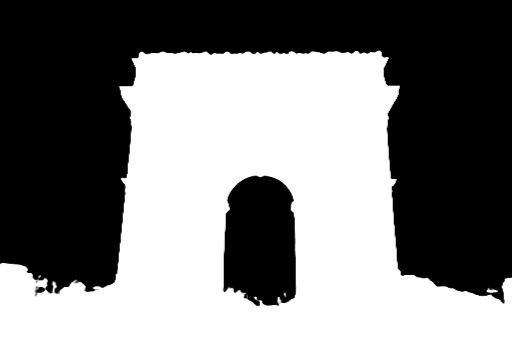

In [19]:
get_mask_img = get_mask(image_url)

get_mask_img.thumbnail((512, 512), Image.Resampling.LANCZOS)
get_mask_img

In [20]:
get_stats(get_mask_img)

Number of pixels: 175,104

Number of black pixels: 90,685 51.79%
Number of white pixels: 84,419 48.21%


## Test 4

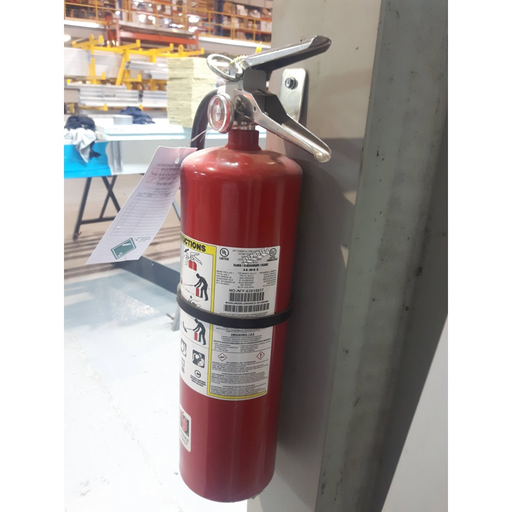

In [29]:
image_url = "https://github.com/retkowsky/removing_background_azure_computer_vision_4/blob/main/fire_extinguisher.jpg?raw=true"

r = requests.get(image_url)
img = Image.open(BytesIO(r.content))
img.thumbnail((512, 512), Image.Resampling.LANCZOS)
img

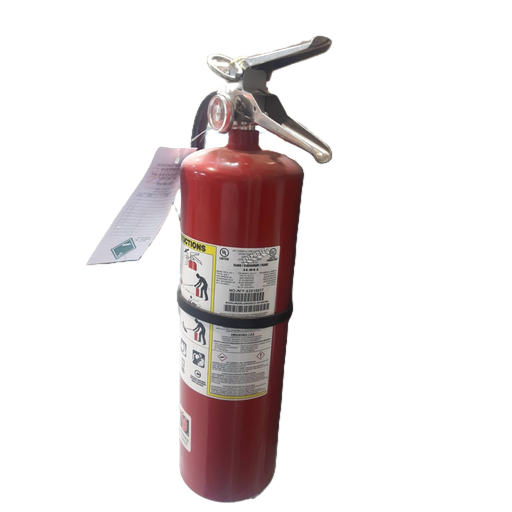

In [30]:
remove_background_img = remove_background(image_url)

remove_background_img.thumbnail((512, 512), Image.Resampling.LANCZOS)
remove_background_img

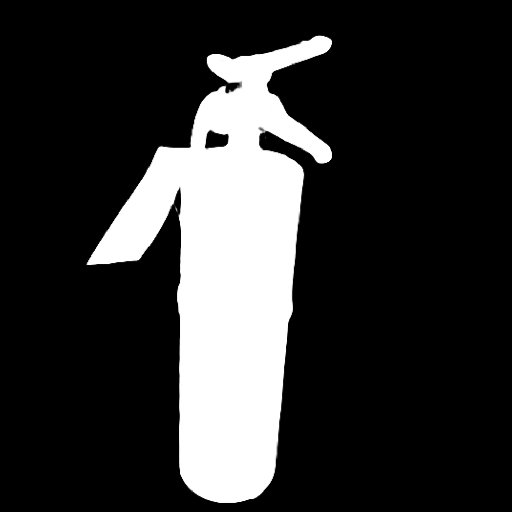

In [31]:
get_mask_img = get_mask(image_url)

get_mask_img.thumbnail((512, 512), Image.Resampling.LANCZOS)
get_mask_img

In [28]:
get_stats(get_mask_img)

Number of pixels: 262,144

Number of black pixels: 209,616 79.96%
Number of white pixels: 52,528 20.04%
